In [11]:
import os
import numpy as np
import imageio.v3 as imageio
import matplotlib.pyplot as plt
import cv2
import glob
import pandas as pd
%matplotlib widget
%load_ext autoreload
%autoreload 2
from amftrack.pipeline.functions.image_processing.extract_graph import (
    from_sparse_to_graph,
    generate_nx_graph,
    clean_degree_4,
)
import scipy
from matplotlib import gridspec
from scipy.signal import correlate, correlation_lags
from scipy.stats import pearsonr
from pathlib import Path
from tqdm import tqdm
from itertools import groupby
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
directory_target = "/gpfs/scratch1/shared/amftrackflow/Drp_downs/"
# target_files = sorted(glob.glob(directory_target + "*/*/*/*/*flux_array.tiff"))
target_excels = sorted(glob.glob(directory_target + "**/*.x*"))
ini_read = pd.read_excel(target_excels[0], nrows=0)

for file in target_excels:
    read = pd.read_excel(file)
    ini_read = pd.concat([ini_read, read], ignore_index=True)
    

In [3]:
len(ini_read["Unnamed: 0"].unique())

852

In [4]:
videos_data = ini_read

videos_data["Time after crossing"].unique

videos_data = videos_data.drop(videos_data[videos_data['Growing temperature'].isnull()].index)
videos_data = videos_data.drop(videos_data[videos_data['Bright-field (BF)\nor\nFluorescence (F)'] == "BF"].index)
# videos_data = videos_data.drop(videos_data[videos_data['Magnification'].ge(6)].index)

videos_data["Plate_nr"] = [int(line.split("_")[-2][5:]) for line in videos_data['Unnamed: 0']]
videos_data["Magnification"] = [int(mag) for mag in videos_data["Magnification"]]
videos_data["FPS"] = [int(mag) for mag in videos_data["FPS"]]
videos_data["Time after crossing"] = [int(mag.split(' ')[-2]) for mag in videos_data["Time after crossing"]]
# videos_data = videos_data.drop(videos_data[videos_data['Time after crossing'].ge(10)].index)
videos_data["Address"] = [glob.glob(directory_target + '*/' + name.split("_")[-3] + '*' + name[13:]) for name in videos_data["Unnamed: 0"]]
videos_data = videos_data[videos_data['Address'].map(len) > 0]
videos_data["Address"] = [entry[0] for entry in videos_data["Address"]]
videos_data["Edges"] = [glob.glob(entry + '/Analysis/edge *') for entry in videos_data["Address"]]
videos_data = videos_data.explode("Edges")
videos_data = videos_data.drop(videos_data[videos_data['Edges'].isnull()].index)
videos_data.index = range(len(videos_data))

print(len(videos_data["Unnamed: 0"].unique()))

videos_data


461


,Unnamed: 0,Treatment,Strain,Time after crossing,Growing temperature,Position mm,Unnamed: 6,dcenter mm,droot mm,Bright-field (BF)\nor\nFluorescence (F),Magnification,FPS,Comments,Binned (Y/N),Video Length (s),Plate_nr,Address,Edges
0,20221026_plate452_16,1%P100&N,C2,10,25.0,11060,46280,-33.0,-3.0,F,4,10,SET 1\n30 seconds. Part of network out of focus,NaN,NaN,452,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
1,20221026_plate452_16,1%P100&N,C2,10,25.0,11060,46280,-33.0,-3.0,F,4,10,SET 1\n30 seconds. Part of network out of focus,NaN,NaN,452,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
2,20221026_plate452_16,1%P100&N,C2,10,25.0,11060,46280,-33.0,-3.0,F,4,10,SET 1\n30 seconds. Part of network out of focus,NaN,NaN,452,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
3,20221026_plate452_16,1%P100&N,C2,10,25.0,11060,46280,-33.0,-3.0,F,4,10,SET 1\n30 seconds. Part of network out of focus,NaN,NaN,452,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
4,20221026_plate452_16,1%P100&N,C2,10,25.0,11060,46280,-33.0,-3.0,F,4,10,SET 1\n30 seconds. Part of network out of focus,NaN,NaN,452,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1234,20230201_Plate558_39,1%P100%N,C2,23,25.0,34220,22480,-10.0,21.0,F,4,10,NaN,Y,60.0,558,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
1235,20230201_Plate558_39,1%P100%N,C2,23,25.0,34220,22480,-10.0,21.0,F,4,10,NaN,Y,60.0,558,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
1236,20230201_Plate558_39,1%P100%N,C2,23,25.0,34220,22480,-10.0,21.0,F,4,10,NaN,Y,60.0,558,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...
1237,20230201_Plate558_41,1%P100%N,C2,23,25.0,34380,22600,-10.0,21.0,F,50,20,NaN,Y,30.0,558,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...,/gpfs/scratch1/shared/amftrackflow/Drp_downs/2...


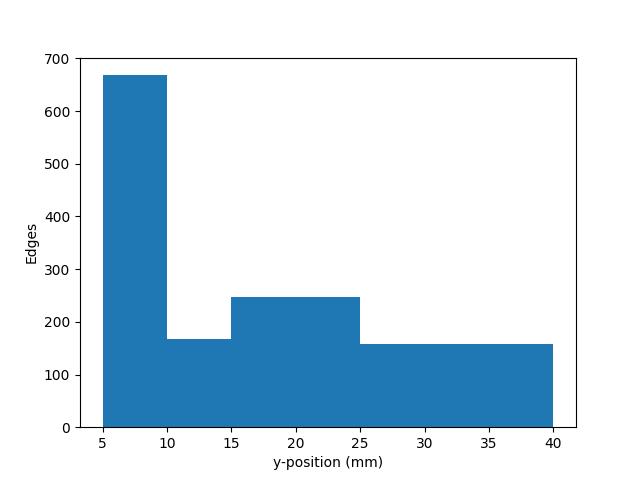

[ 5. 10. 15. 25. 40.]


In [5]:
# print(np.array(videos_data["Time after crossing"]))

plt.figure()
bins = plt.hist(np.array(videos_data["Time after crossing"]), bins = [5, 10, 15, 25, 40])
plt.xlabel("y-position (mm)")
plt.ylabel("Edges")
plt.show()
print(bins[1])

In [15]:
result_bins = [[] for i in range(len(bins[1]))]
age_bins = [5, 10, 15, 30]
# print(result_bins)

plt.close('all')

avg_speeds = []
avg_straights_speeds = []
bulkies = 0
coverage_thresh = 0.3
spd_max_percentile = 99.9
range_percentile = 98
std_thresh = 0.25

for index, edge_entry in tqdm(videos_data.iterrows()):
    edge_name = edge_entry["Edges"].split(os.sep)[-1][5:]
    spd_tiff_address = str(edge_entry["Edges"]) + f"{os.sep}{edge_name}_speeds_flux_array.tiff"
#     print(spd_tiff_address)
    if not os.path.exists(spd_tiff_address):
        continue
    kymo_tiff_address = str(edge_entry["Edges"]) + f"{os.sep}{edge_name}_kymos_array.tiff"
    spd_tiff = imageio.imread(spd_tiff_address)
    area_coverage = np.sum(~np.isnan(spd_tiff[2].flatten())) / len(spd_tiff[2].flatten())
    if area_coverage < coverage_thresh:
        continue
    
    fps = edge_entry['FPS']
    magnification= edge_entry['Magnification']
    binning = np.where(edge_entry['Binned (Y/N)'] == 'Y', 2, 1)
    
    space_pixel_size = 2 * 1.725 / (magnification) * binning
    time_pixel_size = 1/fps
    
    kymo_tiff = imageio.imread(kymo_tiff_address)
    kymo_tiff[1] = np.divide(kymo_tiff[1], 2.0)
    
    coverage_fold = [(np.sum(~np.isnan(spd_tiff[1][i])) / np.sum(~np.isnan(spd_tiff[2][i]))) / (np.sum(~np.isnan(spd_tiff[0][i])) / np.sum(~np.isnan(spd_tiff[2][i]))) for i in range(len(kymo_tiff[0]))]

    kymo_tiff_back = np.where(np.isnan(spd_tiff[0]), np.nan, kymo_tiff[2])
    kymo_tiff_forw = np.where(np.isnan(spd_tiff[1]), np.nan, kymo_tiff[3])
    times = np.linspace(0, len(kymo_tiff[0])*time_pixel_size, len(kymo_tiff[0]))
    speedmax = np.nanpercentile(abs(spd_tiff[0:2].flatten()), spd_max_percentile)
    vel_adj = np.where(np.isinf(np.divide(spd_tiff[2] , kymo_tiff[1])), np.nan, np.divide(spd_tiff[2] , kymo_tiff[1]))
    vel_adj = np.where(abs(vel_adj) > 2*speedmax, np.nan, vel_adj)
    
#     vel_adj = spd_tiff[2]
    
    vel_adj_mean = np.nanmean(vel_adj, axis=1)
    vel_adj_mean_mean = np.nanmean(vel_adj_mean)
    vel_bin = np.digitize(edge_entry["Time after crossing"], bins[1])
    
    vel_back_adj = [spd_tiff[0][i] * kymo_tiff[2][i] / np.nansum(kymo_tiff_back[i]) for i in range(len(kymo_tiff[0]))]
    vel_back_adj_mean= np.nansum(vel_back_adj, axis=1)
    vel_back_adj_mean_mean = np.mean(vel_back_adj_mean)
    vel_back_adj_mean_std = np.std(vel_back_adj_mean) / vel_back_adj_mean_mean
    vel_back_adj_std = np.nanstd(spd_tiff[0], axis=1)
    
    vel_forw_adj = [spd_tiff[1][i] * kymo_tiff[3][i] / np.nansum(kymo_tiff_forw[i]) for i in range(len(kymo_tiff[0]))]
    vel_forw_adj_mean= np.nansum(vel_forw_adj, axis=1)
    vel_forw_adj_mean_mean = np.mean(vel_forw_adj_mean)
    vel_forw_adj_mean_std = np.std(vel_forw_adj_mean) / vel_forw_adj_mean_mean
    vel_forw_adj_std = np.nanstd(spd_tiff[1], axis=1)
    
#     if -vel_back_adj_mean_std < std_thresh or vel_forw_adj_mean_std > std_thresh:
#         continue
    
    speed_range = np.percentile(np.nanmean(vel_adj, axis=1), range_percentile) - np.percentile(np.nanmean(vel_adj, axis=1), 100 - range_percentile)
    
#     coverage_fold = np.log(coverage_fold) > 0
#     count_dups = np.array([sum(1 for _ in group) for _, group in groupby(coverage_fold)])
#     count_dups = count_dups[count_dups > 10] * time_pixel_size
    
#     if speed_range > 5:
#         fig, ax = plt.subplots(1,2)
#         fig.suptitle(f"{count_dups[1:-1]}")
#         ax[0].imshow(kymo_tiff[0])
#         ax[1].plot(coverage_fold)
    
    result_bins[vel_bin].append([vel_adj_mean_mean, np.digitize(int(edge_entry["Time after crossing"]), age_bins)])
#     print(np.digitize(int(edge_entry["Time after crossing"]), age_bins))

#     imshow_extent = [0, space_pixel_size * kymo_tiff[0].shape[1],
#         time_pixel_size * kymo_tiff[0].shape[0], 0]
        
#     fig, ax = plt.subplots(1,4, figsize=(9, 3))
# #     fig.suptitle(f"Edge {edge_name} from video {edge_entry['Unnamed: 0']}, \n forw mean {vel_forw_adj_mean_mean:.4}, std {vel_forw_adj_mean_std:.4} \n back mean {vel_back_adj_mean_mean:.4}, std {vel_back_adj_mean_std:.4}")
#     ax[0].imshow(kymo_tiff[1], extent = imshow_extent, aspect='auto')
#     ax[0].set_title("Kymograph")
#     ax[1].set_title("Mean velocity field")
#     ax[3].set_title("Mean velocity")
#     ax[2].set_title("Split velocities")

#     ax[1].imshow(vel_adj, extent = imshow_extent, vmin=-speedmax, vmax=speedmax, aspect='auto', cmap='coolwarm')
#     ax[3].plot(times, np.nanmean(vel_adj, axis=1))
# #     ax[2].fill_between(times, np.nanmean(vel_adj, axis=1)-np.nanstd(vel_adj, axis=1), np.nanmean(vel_adj, axis=1)+np.nanstd(vel_adj, axis=1),
# #                         alpha=0.3, edgecolor='black', facecolor='tab:blue', linewidth=0)
#     ax[2].plot(times, vel_back_adj_mean)
#     ax[2].fill_between(times, vel_back_adj_mean-vel_back_adj_std, vel_back_adj_mean+vel_back_adj_std,
#                         alpha=0.3, edgecolor='black', facecolor='tab:blue', linewidth=0)
#     ax[2].plot(times, vel_forw_adj_mean)
#     ax[2].fill_between(times, vel_forw_adj_mean-vel_forw_adj_std, vel_forw_adj_mean+vel_forw_adj_std,
#                         alpha=0.3, edgecolor='black', facecolor='tab:orange', linewidth=0)
#     ax[0].set_ylabel('time (s)')
#     ax[2].set_ylabel('Speed ($\mu m / s$)')


#     for i in range(0,2):
#         ax[i].set_xlabel("length ($\mu m$)")
    
#     for i in range(2,4):
#         ax[i].set_ylim([-25, 25])
#         ax[i].grid(True)
#         ax[i].set_xlabel('time (s)')
# #         ax[i].set_ylabel("Speed ($\mu m / s$)")
#         ax[i].axhline(c='black')

#     fig.tight_layout()
    


56it [00:08,  5.64it/s]/scratch-local/svstaalduine/ipykernel_2583068/2096868772.py:43: RuntimeWarning: divide by zero encountered in true_divide
  vel_adj = np.where(np.isinf(np.divide(spd_tiff[2] , kymo_tiff[1])), np.nan, np.divide(spd_tiff[2] , kymo_tiff[1]))
79it [00:11,  8.44it/s]/scratch-local/svstaalduine/ipykernel_2583068/2096868772.py:37: RuntimeWarning: invalid value encountered in long_scalars
  coverage_fold = [(np.sum(~np.isnan(spd_tiff[1][i])) / np.sum(~np.isnan(spd_tiff[2][i]))) / (np.sum(~np.isnan(spd_tiff[0][i])) / np.sum(~np.isnan(spd_tiff[2][i]))) for i in range(len(kymo_tiff[0]))]
/scratch-local/svstaalduine/ipykernel_2583068/2096868772.py:37: RuntimeWarning: divide by zero encountered in double_scalars
  coverage_fold = [(np.sum(~np.isnan(spd_tiff[1][i])) / np.sum(~np.isnan(spd_tiff[2][i]))) / (np.sum(~np.isnan(spd_tiff[0][i])) / np.sum(~np.isnan(spd_tiff[2][i]))) for i in range(len(kymo_tiff[0]))]
/scratch-local/svstaalduine/ipykernel_2583068/2096868772.py:48: Runt

0
573
146
228
145


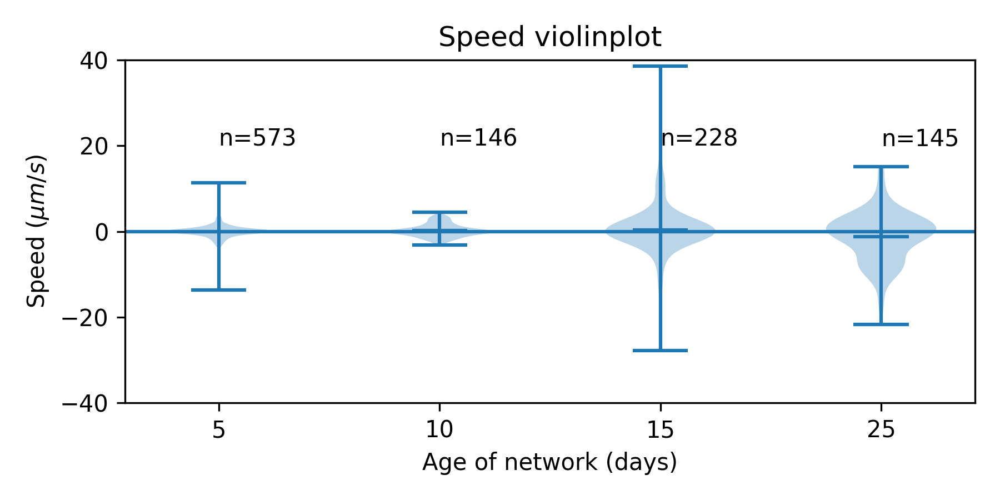

In [16]:
from matplotlib.lines import Line2D
# print(np.array(result_bins).T)

for result in result_bins:
    print(len(result))

result_speeds = [np.array(result).T[0] for result in result_bins[1:]]
# print(result_speeds[0])
result_ages = [np.array(result).T[1] for result in result_bins[1:]]
# for i, ypos in enumerate(result_ages):
# #     print(ypos == 1)
#     result_speeds[i] = result_speeds[i][ypos==1]
#     print(len(result_speeds[i]))
    

fig, ax = plt.subplots( figsize=(6, 3))
violplot = ax.violinplot(result_speeds, range(1, len(bins[1])), showmeans=True)
violmaxes = np.array(violplot["cmaxes"].get_segments()).T[1][0]

for i, result in enumerate(result_bins):
    ax.annotate(f"n={len(result)}", (i, 20))


ax.set_title(f"Speed violinplot")
ax.set_ylabel("Speed ($\mu m / s$)")
ax.set_ylim([-40, 40])
ax.set_xlabel("Age of network (days)")
ax.set_xticks(range(1, len(bins[1])),[f"{int(bins[1][i])}" for i in range(len(bins[1])-1)])
ax.axhline()

# for i, result in enumerate(result_speeds):
# #     print(len(result))
#     result_adjust = (result_ages[i] - 2) * 0.2 + i+1
#     ax[1].scatter(result_adjust, result, c=[["tab:blue", "tab:orange", "tab:green"][int(result_age - 1)] for result_age in result_ages[i]])
# ax[1].set_title("Scatter plot of position and age of the network")
# ax[1].set_xlabel("binned y-position")
# ax[1].set_xticks(range(1, len(bins[1])+1),[f"{int(bins[1][i])}" for i in range(len(bins[1]))])
# ax[1].set_ylim([-40, 40])

# legend_elements = [Line2D([0], [0], marker='o', color='tab:orange', label='5 days'),
#                    Line2D([0], [0], marker='o', color='tab:blue', label='10 days'),
#                    Line2D([0], [0], marker='o', color='tab:green', label='20 days'),
#                   ]
# ax[1].legend(handles=legend_elements)

fig.tight_layout()

In [133]:
# videos_data = ini_read

avg_speeds = []
for test_index in tqdm(range(len(target_files))):
    video_name = target_files[test_index].split('/')[-4]
    
    print(video_name)
    
    video_data = videos_data[videos_data['Unnamed: 0'].str.contains(video_name, case=False, na=False)]
    
    print(video_data)
#     print(video_data.to_string())
#     video_data = video_data.iloc[0]
    
    if video_data['Bright-field (BF)\nor\nFluorescence (F)'] == 'BF':
        continue

    fps = video_data['FPS']
    magnification= video_data['Magnification']
    binning = np.where(video_data['Binned (Y/N)'] == 'Y', 2, 1)

    space_pixel_size = 2 * 1.725 / (magnification) * binning
    time_pixel_size = 1/fps
    


    test_tiff = imageio.imread(target_files[test_index])
    kymos_address = sorted(Path(target_files[test_index]).parent.glob("*_kymos_array.tiff"))

    kymo_tiff = imageio.imread(str(kymos_address[0]))[1]
    kymo_tiff_back = np.where(np.isnan(test_tiff[0]), np.nan, kymo_tiff)
    kymo_tiff_forw = np.where(np.isnan(test_tiff[1]), np.nan, kymo_tiff)

    times = np.linspace(0, len(kymo_tiff)*time_pixel_size, len(kymo_tiff))

#     print(video_data)
#     print(target_files[test_index])

    speedmax = np.nanpercentile(abs(test_tiff[0:1].flatten()), 95)

    vel_back_adj = [test_tiff[0][i] * kymo_tiff[i] / np.nansum(kymo_tiff_back[i]) for i in range(len(kymo_tiff))]
    vel_back_adj_mean= np.nansum(vel_back_adj, axis=1)
    vel_back_adj_std = np.nanstd(test_tiff[0], axis=1)

    vel_forw_adj = [test_tiff[1][i] * kymo_tiff[i] / np.nansum(kymo_tiff_forw[i]) for i in range(len(kymo_tiff))]
    vel_forw_adj_mean= np.nansum(vel_forw_adj, axis=1)
    vel_forw_adj_std = np.nanstd(test_tiff[1], axis=1)
    
    vel_adj = test_tiff[2] / kymo_tiff

    forw_coverage = [np.sum(~np.isnan(test_tiff[1][i]))/np.sum(~np.isnan(test_tiff[2][i])) for i in range(len(test_tiff[2]))]
    back_coverage = [np.sum(~np.isnan(test_tiff[0][i]))/np.sum(~np.isnan(test_tiff[2][i])) for i in range(len(test_tiff[2]))]

#     fig, ax = plt.subplots(1,3, figsize=(9,3))
#     for i in range(3):
#         ax[i].imshow(test_tiff[i], cmap='coolwarm', aspect='auto', vmin = -speedmax, vmax = speedmax)
#     fig.tight_layout()
    
#     fig, ax = plt.subplots(1,2, figsize = (9,3))
#     ax[0].plot(times, vel_back_adj_mean)
#     ax[0].fill_between(times, vel_back_adj_mean-vel_back_adj_std, vel_back_adj_mean+vel_back_adj_std,
#                         alpha=0.3, edgecolor='black', facecolor='tab:blue', linewidth=0)
#     ax[0].plot(times, vel_forw_adj_mean)
#     ax[0].fill_between(times, vel_forw_adj_mean-vel_forw_adj_std, vel_forw_adj_mean+vel_forw_adj_std,
#                         alpha=0.3, edgecolor='black', facecolor='tab:orange', linewidth=0)
#     ax[0].axhline(c='black')
#     ax[1].axhline(c='black')

#     ax[0].grid(True)
#     ax[1].grid(True)


#     ax[1].plot(vel_back_adj_mean * back_coverage + vel_forw_adj_mean * forw_coverage)

#     fig.tight_layout()

#     print(np.mean(vel_back_adj_mean * back_coverage + vel_forw_adj_mean * forw_coverage))
    if not np.isnan(np.mean(vel_back_adj_mean * back_coverage + vel_forw_adj_mean * forw_coverage)):
        avg_speeds.append(np.mean(vel_back_adj_mean * back_coverage + vel_forw_adj_mean * forw_coverage))
print(np.array(avg_speeds))



  0%|                                                                                                                   | 0/2166 [00:00<?, ?it/s]

20221026_Plate452_01
Empty DataFrame
Columns: [Unnamed: 0, Treatment, Strain, Time after crossing, Growing temperature, Position mm, Unnamed: 6, dcenter mm, droot mm, Bright-field (BF)
or
Fluorescence (F), Magnification, FPS, Comments, Binned (Y/N), Video Length (s), Plate_nr, Address]
Index: []


IndexError: single positional indexer is out-of-bounds

29it [00:03,  8.73it/s]


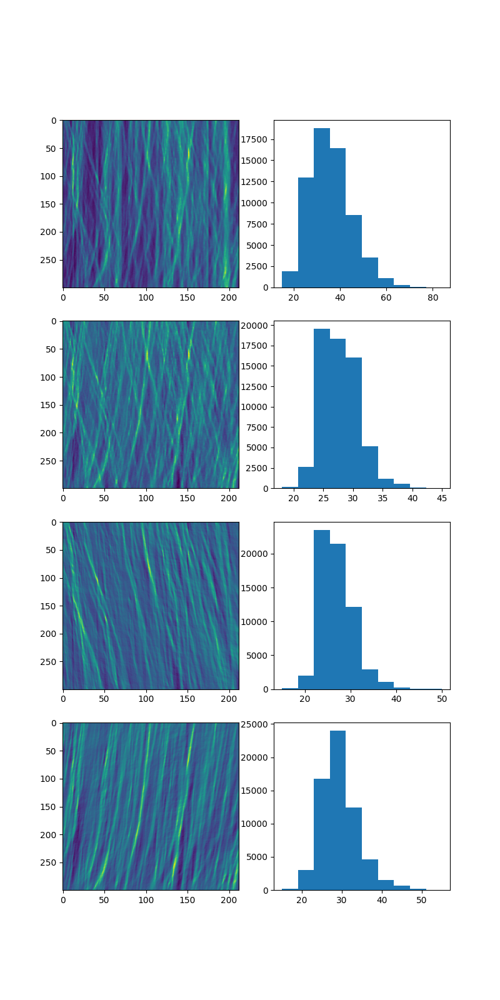

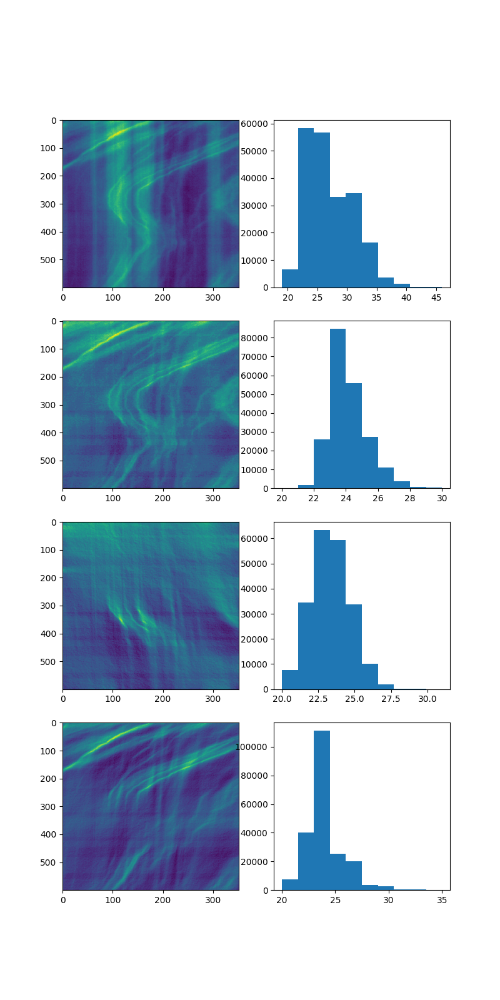

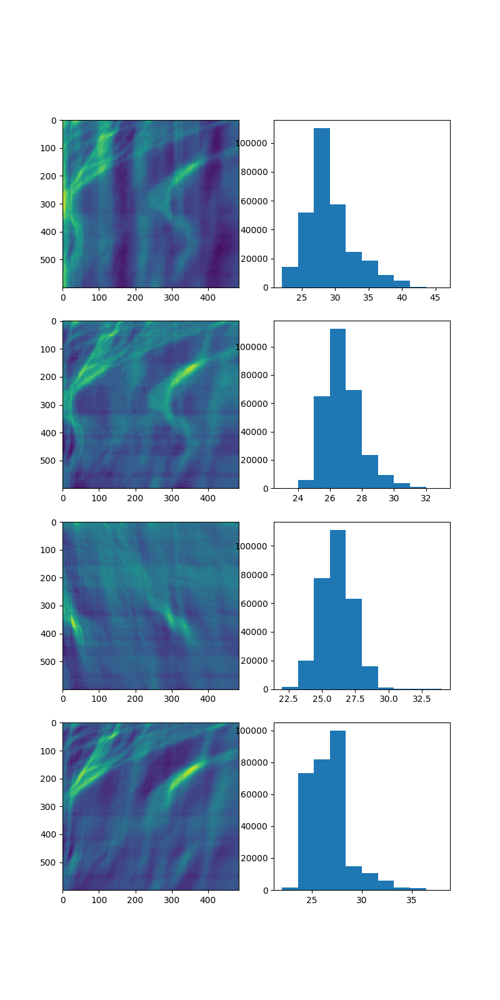

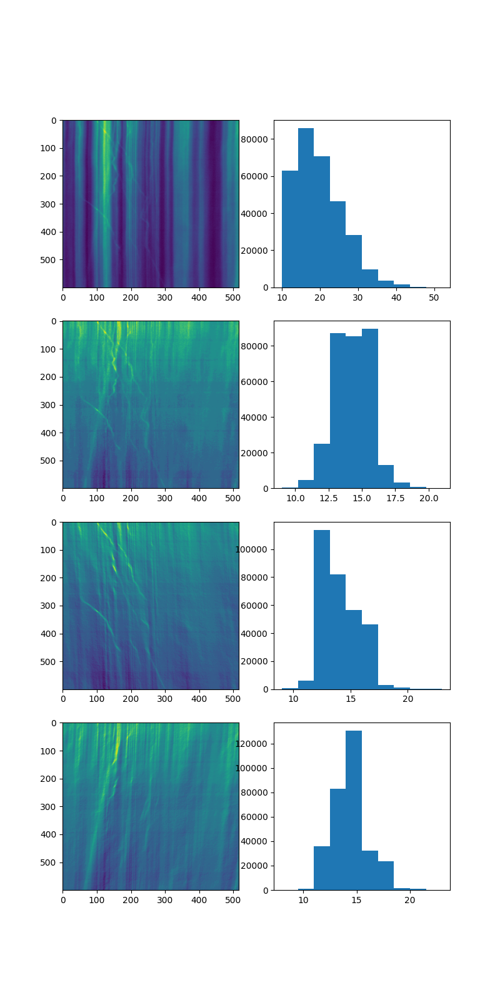

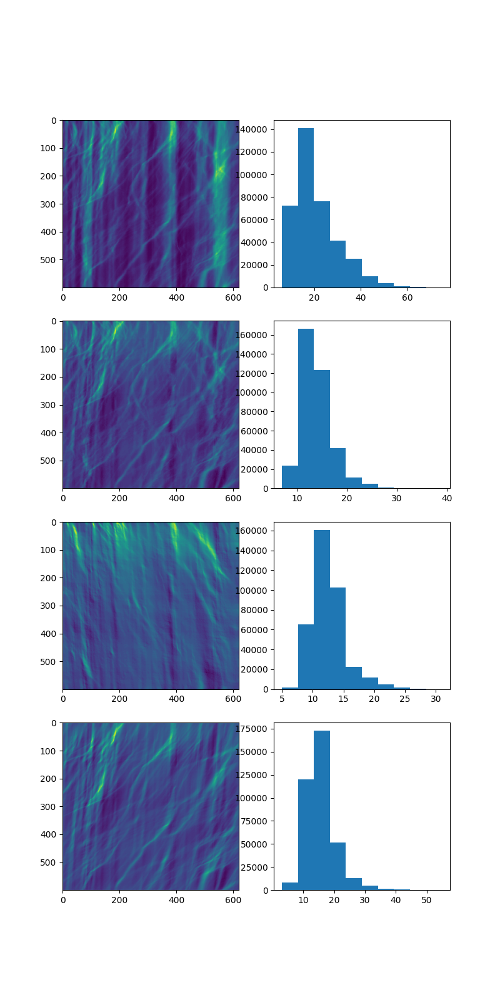

...

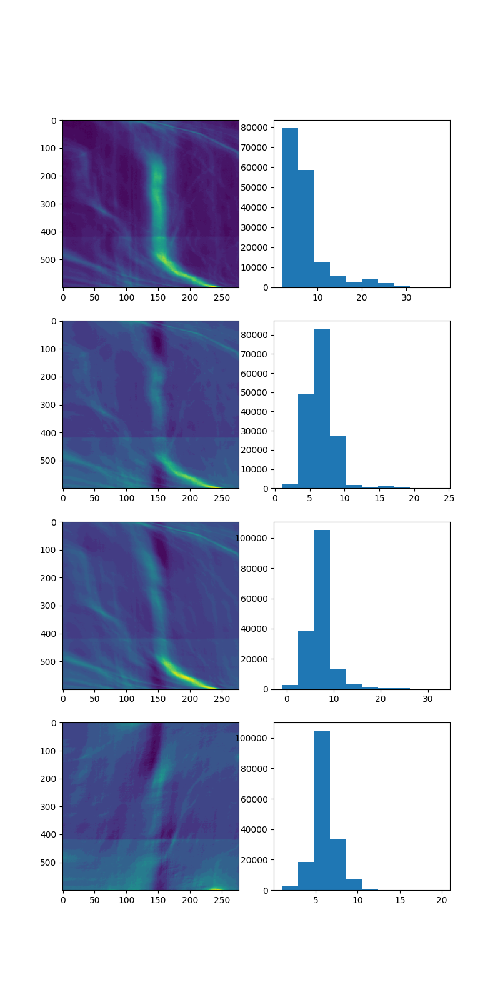

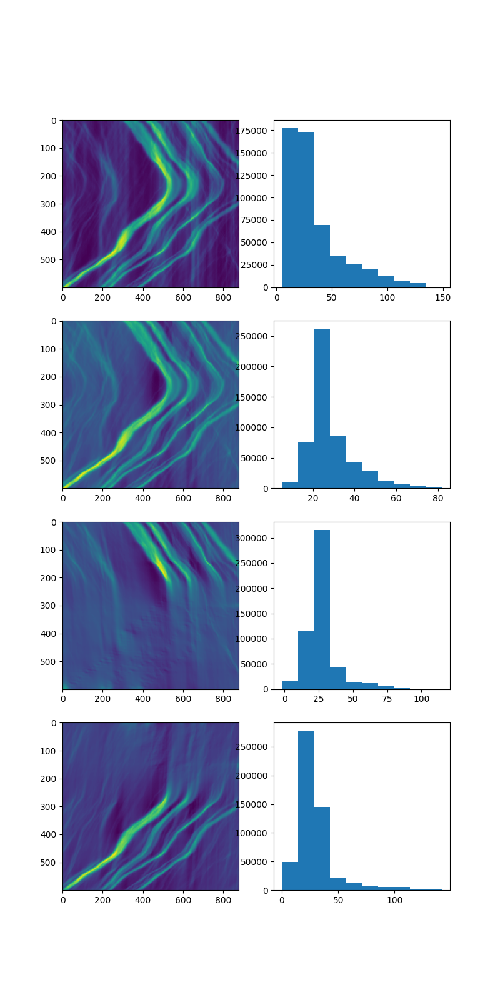

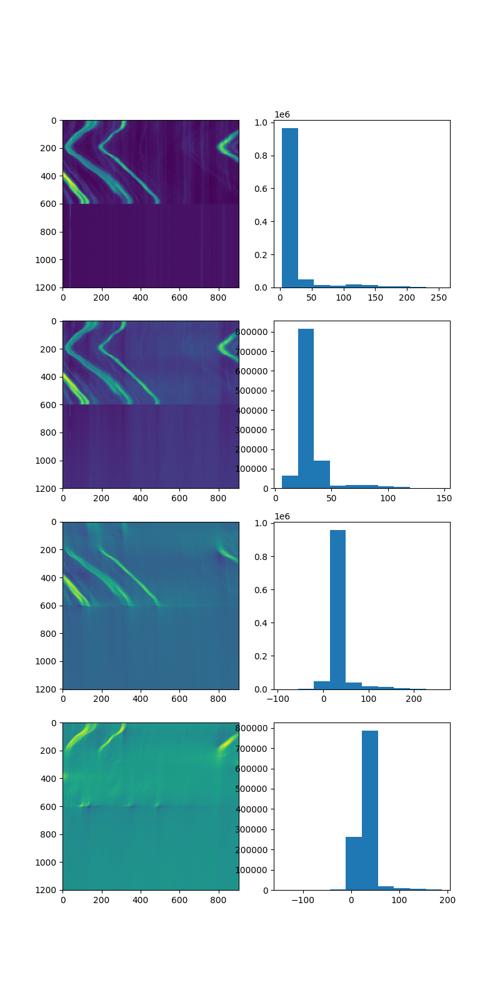

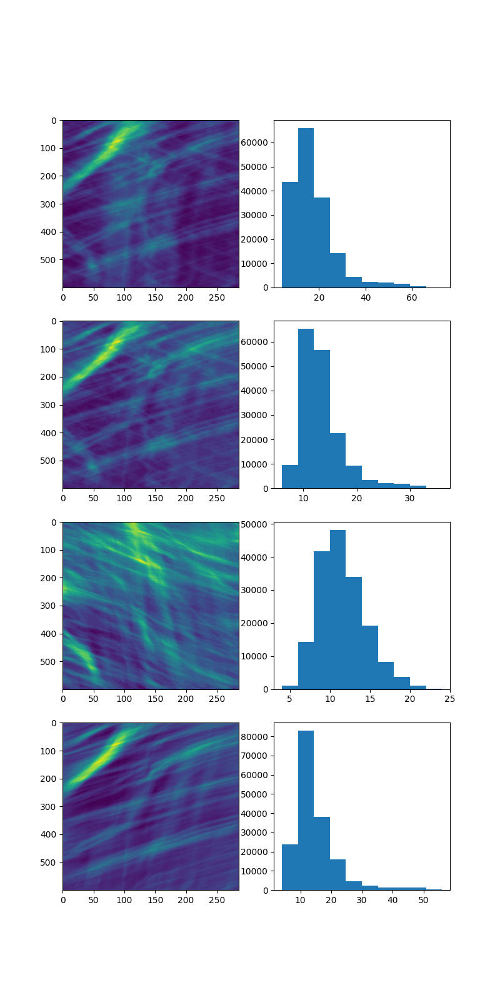

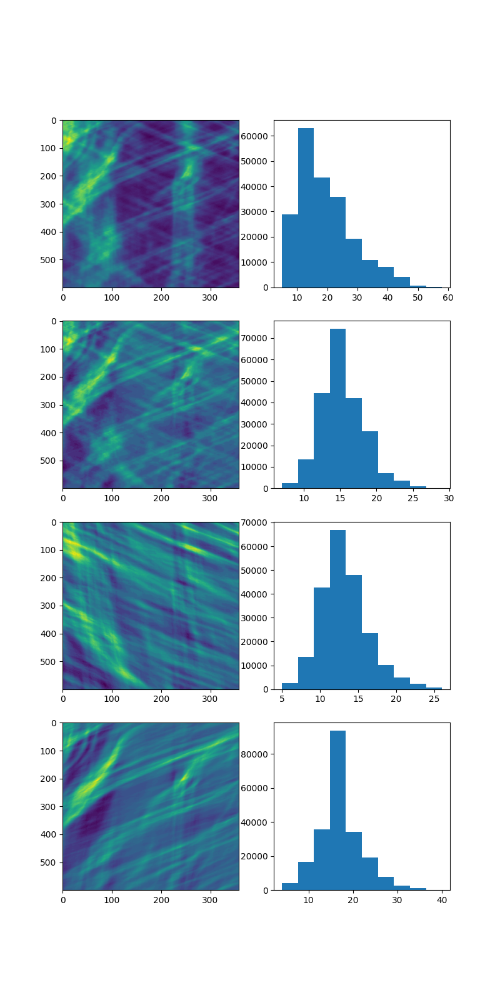

In [204]:
avg_speeds = []
coverage_thresh = 0.3

for index, edge_entry in tqdm(videos_data.iloc[1:30].iterrows()):
    edge_name = edge_entry["Edges"].split('/')[-1][5:]
    spd_tiff_address = str(edge_entry["Edges"]) + "/" + edge_name + "_speeds_flux_array.tiff"
    if not os.path.exists(spd_tiff_address):
        continue
    kymo_tiff_address = str(edge_entry["Edges"]) + "/" + edge_name + "_kymos_array.tiff"
    spd_tiff = imageio.imread(spd_tiff_address)
    area_coverage = np.sum(~np.isnan(spd_tiff[2].flatten())) / len(spd_tiff[2].flatten())
    if area_coverage < coverage_thresh:
        continue
    kymo_tiff = imageio.imread(kymo_tiff_address)
    kymo_tiff[1] = np.divide(kymo_tiff[1], 2.0)
    fig, ax = plt.subplots(4,2, figsize = (8, 16))
    for i in range(4):
        ax[i][0].imshow(kymo_tiff[i], aspect='auto')
        ax[i][1].hist(kymo_tiff[i].flatten())